In [1]:
require(cowplot)
require(data.table)
require(ggplot2)
require(ggpubr)
require(pbapply)
pboptions(type="timer")
require(viridis)

source("../manuscript/functions/save_and_plot.R")

Loading required package: cowplot

Loading required package: data.table

Loading required package: ggplot2

Loading required package: ggpubr


Attaching package: ‘ggpubr’


The following object is masked from ‘package:cowplot’:

    get_legend


Loading required package: pbapply

Loading required package: viridis

Loading required package: viridisLite



In [2]:
root = "../data/strip_of_tissue"
nthreads=10

In [3]:
list.files(file.path(root, "raw"), pattern="spots", full.name=T)
list.files(file.path(root, "dw"), pattern="spots", full.name=T)

[1] "../data/strip_of_tissue/raw/spots_non_DW.csv.gz"

[1] "../data/strip_of_tissue/dw/spots_DW.fov_028.csv.gz"
[2] "../data/strip_of_tissue/dw/spots_DW.fov_029.csv.gz"
[3] "../data/strip_of_tissue/dw/spots_DW.fov_030.csv.gz"
[4] "../data/strip_of_tissue/dw/spots_DW.fov_031.csv.gz"
[5] "../data/strip_of_tissue/dw/spots_DW.fov_032.csv.gz"
[6] "../data/strip_of_tissue/dw/spots_DW.fov_033.csv.gz"
[7] "../data/strip_of_tissue/dw/spots_DW.fov_034.csv.gz"

In [4]:
dots = rbindlist(list(
    rbindlist(lapply(list.files(file.path(root, "raw"), pattern="spots", full.name=T),
                     function(x) { d=fread(x); d$image_type="raw"; return(d)})),
    rbindlist(lapply(list.files(file.path(root, "dw"), pattern="spots", full.name=T),
                     function(x) { d=fread(x); d$image_type="dw"; return(d)}))
))

In [5]:
dots[0 != nchar(target), unique(target)]

[1] "FTH1"        "KLHL5"       "SPARCL1"     "CALM2"       "STMN1"      
  [6] "CDH13"       "SLC1A2"      "ANXA1"       "OPALIN"      "ETNPPL"     
 [11] "NTM"         "ENC1"        "SLC6A1"      "SERPINE2"    "RIMS2"      
 [16] "OLFM1"       "KCNC2"       "LAMP5"       "NELL2"       "GAD1"       
 [21] "GRIA1"       "CHN1"        "TMEFF2"      "PDE1A"       "SYT1"       
 [26] "GABBR2"      "PCLO"        "PVALB"       "GRIK2"       "SYNPR"      
 [31] "COL5A2"      "DPP10"       "ITPR2"       "CADM2"       "MIAT"       
 [36] "LHX6"        "EDIL3"       "NTNG1"       "CRYM"        "CDH9"       
 [41] "NXPH1"       "NXPH2"       "SCHIP1"      "ERBB4"       "THSD7A"     
 [46] "LDB2"        "GRIA4"       "ARPP21"      "SORBS2"      "CTNNA2"     
 [51] "OXR1"        "PCDH15"      "SMYD1"       "CALB1"       "PTPRD"      
 [56] "GPM6A"       "PDGFRA"      "NCAM2"       "SPOCK1"      "PTPRZ1"     
 [61] "CADPS"       "SLC17A7"     "ZMAT4"       "ID3"         "NOSTRIN"    
 [66] "COL24A1"     "CELF2"       "CNTNAP2"     "CACNA2D1"    "RGS12"      
 [71] "TRHDE"       "MEG3"        "RORB"        "LINC00507"   "SNTG1"      
 [76] "NECAB1"      "PTPRK"       "COL6A1"      "COL21A1"     "PCDH7"      
 [81] "IL1RAPL1"    "TMEM255A"    "IQCJ-SCHIP1" "FSTL5"       "OLFM3"      
 [86] "SLIT2"       "GRIK1"       "ADARB2"      "PCDH9"       "DCN"        
 [91] "ALCAM"       "CNTN3"       "SPOCK3"      "KCNT2"       "SCUBE1"     
 [96] "LRMP"        "CBLN2"       "ANKRD34B"    "FEZF2"       "MIR4500HG"  
[101] "LY86"        "SPHKAP"      "CNTNAP4"     "VIP"         "CDH10"      
[106] "LHFPL3"      "LINCR-0003"  "NDNF"        "COL22A1"     "PAX6"       
[111] "RXFP1"       "MYZAP"       "SULF1"       "KIT"         "TH"         
[116] "RIT2"        "EGFEM1P"     "RELN"        "CMTM8"       "HTR2C"

In [6]:
dim(dots[nchar(target) != 0])

[1] 424371     20

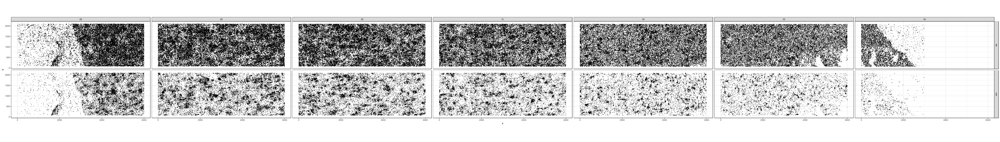

In [7]:
options(repr.plot.width=56, repr.plot.height=8)
ggplot(dots[nchar(target) != 0], aes(x=x, y=y)) + geom_point(pch=".") +
    facet_grid(~image_type~fov) + coord_fixed() +
    theme_bw()

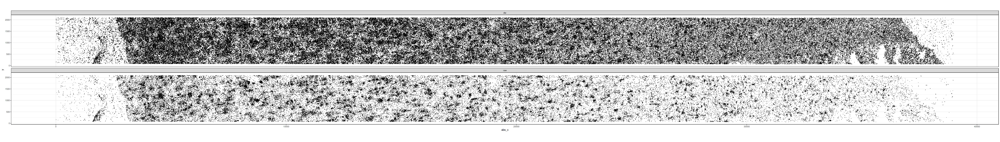

In [8]:
options(repr.plot.width=56, repr.plot.height=8)

dots[, abs_x := x + 6000*(fov-28)]

p = ggplot(dots[(passes_thresholds) & nchar(target) != 0], aes(x=abs_x, y=y)) + geom_point(pch=".") +
    facet_wrap(~image_type, nrow=2) + coord_fixed() +
    theme_bw()
print(p)
ggsave(plot=p, file="plots/strip.all_transcripts.bw.png", width= 32, height=6)

In [20]:
dots[(passes_thresholds) & nchar(target) != 0, .N, by=image_type]

image_type,N
<chr>,<int>
raw,95934
dw,328437


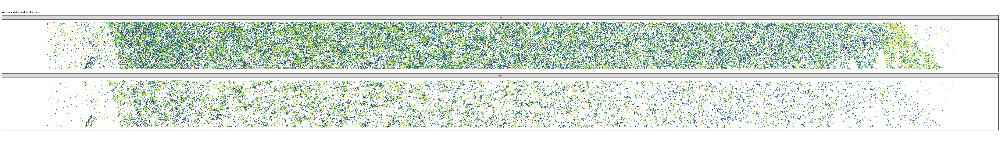

In [10]:
options(repr.plot.width=56, repr.plot.height=8)
p = ggplot(dots[(passes_thresholds) & nchar(target) != 0], aes(x=abs_x, y=y, color=target)) + geom_point(pch=".", size=.5) +
    facet_wrap(~image_type, nrow=2) + coord_fixed() +
    theme_bw() + scale_color_viridis(discrete=T) +
    theme(legend.position="bottom") + guides(color="none") + labs(subtitle="All transcripts, viridis colorspace") +
    theme(axis.text=element_blank(), axis.ticks=element_blank(), axis.title=element_blank(), panel.grid.major=element_blank(), panel.grid.minor=element_blank())
print(p)
save_and_plot(p, "plots/strip.all_transcripts.viridis.scatter", width= 48, height=8, formats=c("png", "jpg", "pdf"))

In [23]:
dots[(passes_thresholds) & nchar(target) != 0, .N, by=image_type]

image_type,N
<chr>,<int>
raw,95934
dw,328437


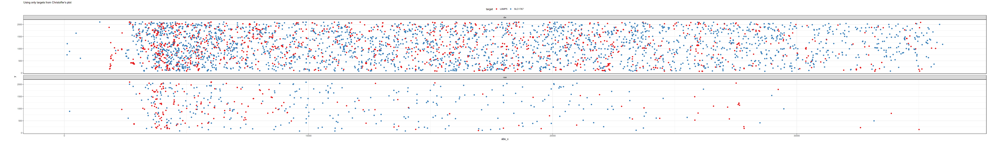

In [11]:
options(repr.plot.width=56, repr.plot.height=8)
p = ggplot(dots[(passes_thresholds) & target %in% c("CD24A", "LAMP5", "MBP", "SLC17A7")], aes(x=abs_x, y=y, color=target)) + geom_point() +
    facet_wrap(~image_type, nrow=2) + coord_fixed() +
    theme_bw() + scale_color_brewer(palette="Set1") +
    theme(legend.position="top") + labs(subtitle="Using only targets from Christoffer's plot")
print(p)
ggsave(plot=p, file="plots/strip.selected_transcripts.viridis.scatter.png", width= 32, height=6)

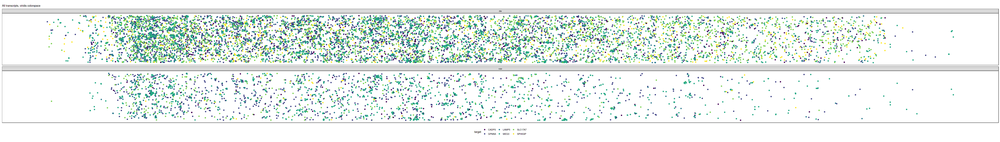

In [12]:
options(repr.plot.width=56, repr.plot.height=8)
p = ggplot(dots[(passes_thresholds) & target %in% c("GPM6A", "MEG3", "SLC17A7", "CADPS", "CBNL2", "SPHKAP", "LAMP5")], aes(x=abs_x, y=y, color=target)) +
    geom_point() +
    facet_wrap(~image_type, nrow=2) + coord_fixed() +
    theme_bw() + scale_color_viridis(discrete=T) +
    theme(legend.position="bottom") + labs(subtitle="All transcripts, viridis colorspace") +
    theme(axis.text=element_blank(), axis.ticks=element_blank(), axis.title=element_blank(), panel.grid.major=element_blank(), panel.grid.minor=element_blank())
print(p)
save_and_plot(p, "plots/strip.top_increasing_transcripts.viridis.scatter", width= 32, height=6, formats=c("png", "jpg", "pdf"))

In [21]:
dots[(passes_thresholds) & target %in% c("GPM6A", "MEG3", "SLC17A7", "CADPS", "CBNL2", "SPHKAP", "LAMP5"), .N, by=image_type]

image_type,N
<chr>,<int>
raw,2789
dw,12556


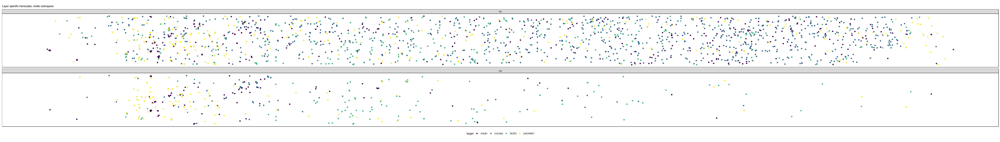

In [13]:
options(repr.plot.width=56, repr.plot.height=8)
p = ggplot(dots[(passes_thresholds) & target %in% c("COL5A2", "CALB1", "FEZF2", "LINC00507")], aes(x=abs_x, y=y, color=target)) +
    geom_point() +
    facet_wrap(~image_type, nrow=2) + coord_fixed() +
    theme_bw() + scale_color_viridis(discrete=T) +
    theme(legend.position="bottom") + labs(subtitle="Layer specific transcripts, viridis colorspace") +
    theme(axis.text=element_blank(), axis.ticks=element_blank(), axis.title=element_blank(), panel.grid.major=element_blank(), panel.grid.minor=element_blank())
print(p)
save_and_plot(p, "plots/strip.layer_specific_transcripts.viridis.scatter", width= 32, height=6, formats=c("png", "jpg", "pdf"))

In [22]:
dots[(passes_thresholds) & target %in% c("COL5A2", "CALB1", "FEZF2", "LINC00507"), .N, by=image_type]

image_type,N
<chr>,<int>
raw,373
dw,2014


In [14]:
b = by(dots[(passes_thresholds)], dots[(passes_thresholds), target], function(target_dots) {
    p = ggplot(target_dots, aes(x=abs_x, y=y)) +
        geom_point(size=1) +
        facet_wrap(~image_type, nrow=2) + coord_fixed() +
        theme_bw() + labs(subtitle=target_dots[1, target])
    ggsave(plot=p, file=sprintf("plots/strip_transcripts/strip.%s.viridis.scatter.png", target_dots[1, target]), width= 32, height=6)
})

In [15]:
dots[(passes_thresholds), .N, by=target][, summary(N)]
high_dot_counts = dots[(passes_thresholds), .N, by=target][N > 6e3, target]
length(high_dot_counts)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   97.0   894.2  1565.0  3536.4  3006.2 75398.0 

[1] 12

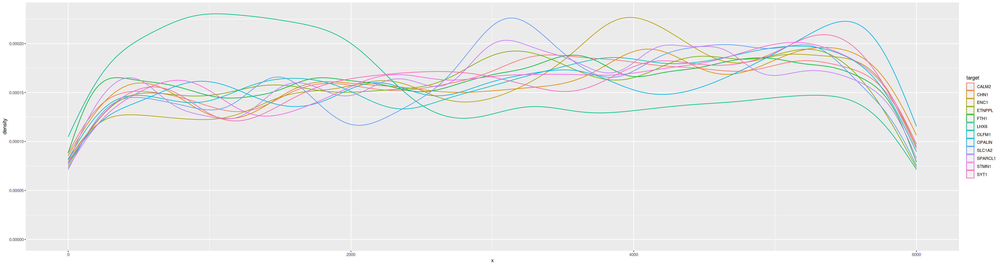

In [16]:
options(repr.plot.width=30, repr.plot.height=8)
ggplot(dots[(passes_thresholds) & target %in% high_dot_counts], aes(x=x)) + geom_density(aes(color=target))

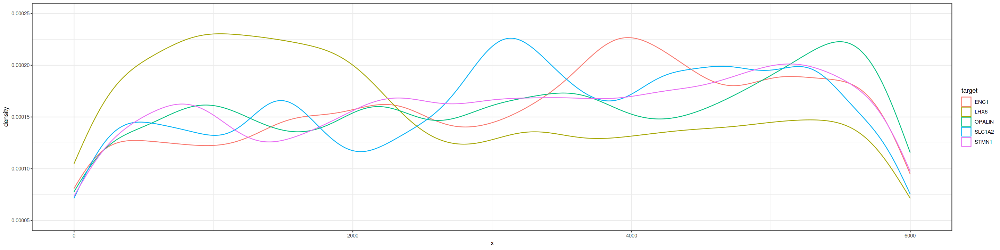

In [17]:
options(repr.plot.width=24, repr.plot.height=6)
ggplot(dots[(passes_thresholds) & target %in% c("LHX6", "SLC1A2", "ENC1", "OPALIN", "STMN1")], aes(x=x)) + geom_density(aes(color=target)) + theme_bw() + coord_cartesian(ylim=c(5e-5, 2.5e-4))

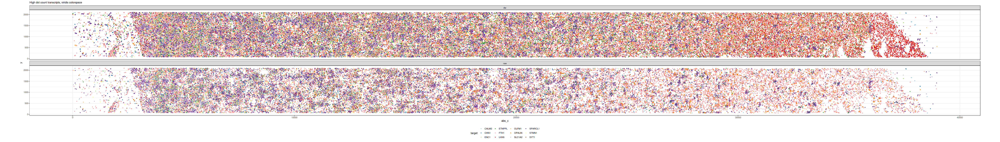

In [18]:
options(repr.plot.width=56, repr.plot.height=8)
p = ggplot(dots[(passes_thresholds) & target %in% high_dot_counts], aes(x=abs_x, y=y, color=target)) +
    geom_point(size=.5) +
    facet_wrap(~image_type, nrow=2) + coord_fixed() +
    theme_bw() + scale_color_brewer(palette="Paired") +
    theme(legend.position="bottom") + labs(subtitle="High dot count transcripts, viridis colorspace")
print(p)
ggsave(plot=p, file="plots/strip.high_dot_counts.viridis.scatter.png", width= 32, height=6)

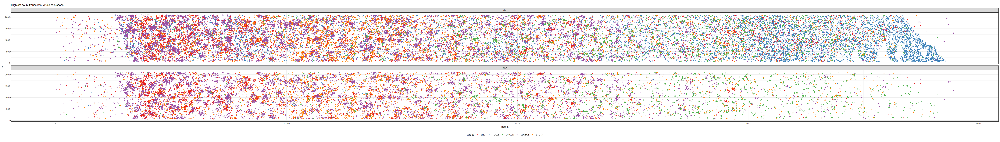

In [19]:
options(repr.plot.width=56, repr.plot.height=8)
p = ggplot(dots[(passes_thresholds) & target %in% c("LHX6", "SLC1A2", "ENC1", "OPALIN", "STMN1")], aes(x=abs_x, y=y, color=target)) +
    geom_point(size=.5) +
    facet_wrap(~image_type, nrow=2) + coord_fixed() +
    theme_bw() + scale_color_brewer(palette="Set1") +
    theme(legend.position="bottom") + labs(subtitle="High dot count transcripts, viridis colorspace")
print(p)
ggsave(plot=p, file="plots/strip.high_dot_counts.manual_selection.viridis.scatter.png", width= 32, height=6)